<a href="https://colab.research.google.com/github/hantablack9/Market-Lead-Scoring-Propensity-Model/blob/main/Market_Lead_scoring.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#LEAD SCORING USING ML ALGORITHMS

> Problem Statement: In this capstone project, you are going to analyze the given data set and build a machine learning algorithm to predict the propensity of buying the course
 Dataset: Purchase_Fraud_Data.csv

---

**Dataset Description:**

Every row in this dataset contains information about the lead. Along with lead details, we also have other details like number of calls made by salesperson, how long it has been since the lead has been generated etc.

- **`Funnel_category`**: created from `stagename` to decrease the number of levels in target column (Target)
- **`stagename`** The stage at which the lead is
- **`opportunity_id`** Lead unique id

- **`subsource`** The subsource from which the lead has been obtained
- **`unanswered_call_counter`** Number of calls that went unanswered
- **`unserviced age`** - No. of days since no action taken on that lead
- **`ageing`** - Days the lead has aged since created
- **`source`**: The source from which the lead has been obtained

- **`Opportunity_created_date`**: Date on which lead was generated
- **`time_taken_for_allocation`**: Time taken to allocate the lead to a salesperson
- **`no_of_calls`**: Number of calls
- **`calldurationinseconds`**: Duration the call from salesperson to the lead lasted
- **`City`**: City the lead belongs to
- **`City Type`**: Whether the city belong to Tier-1, Tier-2 or Tier-3

- **`Laststagechangedate`**- The date when the stage of the lead changes
- **`Sales_end_date`**-Date at which sales end
- **`Sales_start_date`**- Date at which sales start
- **`Program_number`**: The number of the program
- **Program Code -Renewed**: The code of the program
- **`total_program_fee.1`**: The fees of the program
- **`Category`**: Category the program belongs to
- **`Is_serviced_c`**: Whether action is taken on the lead
- **`Business_vertical`**: The business vertical that the program belongs to
- **`Budget`**: Budget allocated for the specific program
- **`Lastactivitydate`**: Last date of activity with the lead
- **`Institute`**: The institute which is offering the program
- **`Year`**: The year in which the lead was generated
- **`Month`**: The month in which the lead was generated
- **`Month_name`**: The name of the month in which the lead was generated
- **`Week of Year`**: The week of the year in which the lead was generated
- **`Week of Month`**: The week of the month in which the lead was generated
- **`Day of Year`**: The day of the year the lead was generated
- **`Day of Week`**: The day of the week the lead was generated
- **`Day Name`**: The name of the day the lead was generated
- **`Age`**: The age range of the lead
- **`Session_Start_day_inweek`**: The day which session starts
- **`Weekly_sessionsdays_count`**: How many sessions in a week

- **`is_session_Working_day`**: Does the session fall on a working day
- **`Workexp`**- The work experience the lead has
- **`workex_reqd`**: work exp required to take the course

- **`sales_Working_day`**: Whether it’s a working day for sales
- **`Time`**: The time at which the lead is generated
- **`Hour`**: The hour at which the lead is generated
- **`IscreatedinWorking_hour`**: Whether the lead is created in working hour of sales


# 1. Importing Dependencies

In [1]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/My Drive/Colab Notebooks/PGCP IIT Roorkee Capstone Files

#https://drive.google.com/drive/folders/1LFKP9ncSSDggD2yNDdNKstdfGQcx5lLQ?usp=drive_link
# /content/drive/MyDrive/Colab Notebooks/PGCP IIT Roorkee Capstone Files/dataset.csv

Mounted at /content/drive
/content/drive/My Drive/Colab Notebooks/PGCP IIT Roorkee Capstone Files


In [2]:
%%capture
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import seaborn.objects as so

%matplotlib inline

In [13]:
%%capture
!pip install causalinference hyperopt hyperas eli5 shap feature_engine polars

# Libraries for Bayesian Optimization and causal inference
import causalinference, hyperopt, hyperas, eli5, shap, feature_engine, polars as pl
from sklearn.model_selection import RandomizedSearchCV

# Libraries for Scaling
from sklearn.preprocessing import StandardScaler

# Libraries for filter-based feature selection
from sklearn.feature_selection import chi2, mutual_info_classif, f_classif, SelectKBest, SelectPercentile
from scipy.stats import kendalltau
from sklearn.feature_selection import RFE, RFECV

import random

#Libraries for model evaluation
from sklearn.metrics import precision_recall_fscore_support, accuracy_score, confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold, StratifiedKFold

# Libraries for model fitting
from sklearn.linear_model import LogisticRegression, Perceptron
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
import xgboost as xgb
from xgboost import XGBClassifier
import tensorflow as tf
import keras
from keras import layers, preprocessing

from sklearn.pipeline import Pipeline


In [4]:
# Set plot style
sns.set(color_codes=True)
sns.set_style("darkgrid")
#plt.style.use("ggplot")
#sns.choose_diverging_palette()
sns.diverging_palette(h_neg = 0, h_pos=355, s=100, l=50, sep=1, n=16, center='dark', as_cmap=False)

plt.rcParams['figure.figsize']=15,8
pd.pandas.set_option('display.max_columns', None)
pd.pandas.set_option('display.max_rows', None)
pd.pandas.set_option('display.float_format', lambda x: '%.3f' % x)

import warnings
warnings.filterwarnings('ignore')

In [5]:
df = pd.read_csv('dataset.csv')
df.to_pickle('./df.pkl')

In [6]:

def change_column_names(df):
  df.columns = df.columns.str.lower().str.replace('-',' ').str.replace(' ', '_').\
  str.replace('__', '_').str.replace('/', '_').str.replace('(', '').str.replace(')', '').str.replace('-','').str.replace('.1', '')
  return df

df1 = change_column_names(df.copy())
df1.columns

Index(['opportunity_id', 'stagename', 'subsource', 'unanswered_call_counter',
       'unserviced_age', 'ageing', 'source', 'opportunity_created_date',
       'time_taken_for_allocation', 'no_of_calls', 'calldurationinseconds',
       'funnel_category', 'days_to_apply', 'days_to_engage', 'days_to_enroll',
       'days_to_payment', 'days_to_waste', 'city', 'city_type', 'workexp',
       'workexp_min', 'workexp_max', 'laststagechangedate', 'is_serviced_c',
       'sales_end_', 'sales_start_date', 'program_number',
       'program_code_renewed', 'total_program_fee', 'category',
       'business_vertical', 'budget', 'lastactivitydate', 'institute',
       'cal_diff', 'call2_diff', 'call3_diff', 'call4_diff', 'year', 'month',
       'month_name', 'week_of_year', 'week_of_month', 'day_of_year',
       'day_of_week', 'day_name', 'age', 'agemin', 'agemax',
       'competitor_program_feehigh', 'competitor_program_feelow',
       'program_start_date_c', 'program_end_date_c', 'sales_working_day',


In [7]:
import copy
df = copy.deepcopy(df1)
del(df1)
display(df.info())
display(df.describe())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 495953 entries, 0 to 495952
Data columns (total 68 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   opportunity_id              495953 non-null  object 
 1   stagename                   495953 non-null  object 
 2   subsource                   494791 non-null  object 
 3   unanswered_call_counter     495953 non-null  int64  
 4   unserviced_age              495882 non-null  float64
 5   ageing                      495953 non-null  int64  
 6   source                      495620 non-null  object 
 7   opportunity_created_date    495953 non-null  object 
 8   time_taken_for_allocation   492232 non-null  float64
 9   no_of_calls                 495953 non-null  int64  
 10  calldurationinseconds       349747 non-null  float64
 11  funnel_category             495953 non-null  object 
 12  days_to_apply               8096 non-null    float64
 13  days_to_engage

None

,unanswered_call_counter,unserviced_age,ageing,time_taken_for_allocation,no_of_calls,calldurationinseconds,days_to_apply,days_to_engage,days_to_enroll,days_to_payment,days_to_waste,workexp_min,workexp_max,total_program_fee,budget,cal_diff,call2_diff,call3_diff,call4_diff,year,month,week_of_year,week_of_month,day_of_year,day_of_week,agemin,agemax,competitor_program_feehigh,competitor_program_feelow,sales_working_day,hour,iscreatedinworking_hour,workex_reqd,is_session_working_day,weekly_sessionsdays_count,sessions_in_week,workex_reqd_workexpmax,workex_reqd_agemax,workex_reqd_agemin
count,495953.000,495882.000,495953.000,492232.000,495953.000,349747.000,8096.000,89782.000,6562.000,578.000,390935.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000,495953.000
mean,1.076,308.082,79.625,2687.444,6.472,148.520,-36.569,-331.930,-100.853,-216.338,-2.973,5.092,9.388,355054.137,2289610.707,4.265,0.020,0.020,0.019,2021.534,5.893,24.494,3.154,163.807,2.853,27.696,32.611,532581.206,236702.758,0.750,10.214,0.496,3.631,0.128,1.242,1.242,0.701,0.113,0.134
std,2.169,1336.824,122.886,33868.689,5.918,324.608,1625.295,3865.969,2485.989,3190.496,903.727,5.015,5.719,391227.460,1788503.299,22.443,0.458,0.585,0.847,0.560,3.230,14.083,1.333,98.932,1.961,6.741,7.185,586841.191,260818.307,0.433,5.326,0.500,2.788,0.334,0.428,0.428,1.304,0.088,0.104
min,0.000,0.000,0.000,-3023.000,1.000,0.000,-44463.421,-44741.746,-43966.712,-44446.583,-43971.323,0.000,1.000,70800.000,161000.000,0.000,0.000,0.000,0.000,2020.000,1.000,1.000,1.000,1.000,0.000,21.000,23.000,106200.000,47200.000,0.000,0.000,0.000,0.000,0.000,1.000,1.000,0.000,0.000,0.000
25%,0.000,0.000,1.000,0.000,2.000,1.000,2.109,0.083,17.099,0.044,3.124,1.000,5.000,152650.000,1510000.000,0.000,0.000,0.000,0.000,2021.000,4.000,15.000,2.000,96.000,1.000,22.000,27.000,228975.000,101766.667,0.000,6.000,0.000,2.000,0.000,1.000,1.000,0.200,0.061,0.071
50%,0.000,0.000,1.000,0.000,5.000,29.000,15.284,0.594,28.582,4.637,10.451,5.000,10.000,225000.000,1797000.000,0.000,0.000,0.000,0.000,2022.000,5.000,21.000,3.000,142.000,3.000,28.000,33.000,337500.000,150000.000,1.000,10.000,0.000,3.000,0.000,1.000,1.000,0.400,0.075,0.091
75%,1.000,0.000,111.000,0.000,9.000,118.000,36.546,5.327,47.289,17.141,21.043,10.000,15.000,360000.000,2112000.000,1.000,0.000,0.000,0.000,2022.000,8.000,36.000,4.000,243.000,5.000,34.000,40.000,540000.000,240000.000,1.000,14.000,1.000,5.000,0.000,1.000,1.000,0.600,0.152,0.179
max,43.000,15922.000,767.000,887999.000,296.000,7706.000,431.760,581.719,520.934,460.937,629.827,30.000,35.000,1652000.000,8687000.000,683.000,99.000,323.000,322.000,2022.000,12.000,53.000,6.000,366.000,6.000,60.000,65.000,2478000.000,1101333.333,1.000,23.000,1.000,10.000,1.000,2.000,2.000,10.000,0.435,0.476


**Strategy:**
- Identify Action features (state changes), map to temporal or other features

- Program Features
- Lead Features
- Threshold features (requirements)

---
- Identify feature importances: feature importance modules with a 40% sample (StratifiedShuffleSplit on the target).

- Categorical: Nominal, Cardinal, and Ordinal features
> Encoding strategies for Ordinal features
> Cardinal features: One-hot
- Numeric: Binary vs Ordinal, Continuous vs Discrete

- Nominal features: dummy variables
- Temporal features: Case-by-case basis (unixtime, week of year, weekend_yes/no)

> - Use Unix date features for model training
- Age groups to dummy variales
-

---
# Business Questions: Customer facing and Business (Mktng/Sales) Facing
1. Do certain demographics have a higher propensity to buy the course?
2. Do certain city tiers show a higher propensity to buy the course?
3. Do certain sales channels have a higher propensity to buy the course?
4. Are there any time-feature dependencies on propensity to buy the course? For eg, do leads generated during certain months show a higher propensity to buy?
5. What is the enrollment rate of the course for different subgroups from the tie of engagement? Ignore cold/wasted leads.
6. Are there hidden clusters in the data? (K-Means + 3D PCA wiz in [TensorFlow projector](https://projector.tensorflow.org) ?)
7. Lag-times dependencies on funnel category.
8. What are the characteristics of wasted and cold leads, compared to other funnel_categories/stagenames? (KL divergence?)
9. Impact of cost considerations on lead propensity and funnel stage.
10. Who is the intended model user? And what would be their keystone metrics? This is useful for EDA, Model Architecture, and Feature Engineering.

# 2. Data Understanding and Exploration

Firstly, there are 5 classes in the target variable. We will use this to check for missing values across features.
The purpose this exercise is to identify if the distribution of Null values is correlated with the classes of the target variable.
> I will build a Null Hypothesis and perform statistical testing to confirm or reject said Null Hypothesis.

In [8]:
categorical_features = [features for features in df.drop('opportunity_id',axis=1).columns if df[features].dtypes == 'O']
numeric_features = [features for features in df.drop('opportunity_id',axis=1).columns if df[features].dtypes != 'O']

display(categorical_features)
print()
display(numeric_features)

['stagename',
 'subsource',
 'source',
 'opportunity_created_date',
 'funnel_category',
 'city',
 'city_type',
 'workexp',
 'laststagechangedate',
 'sales_end_',
 'sales_start_date',
 'program_number',
 'program_code_renewed',
 'category',
 'business_vertical',
 'lastactivitydate',
 'institute',
 'month_name',
 'day_name',
 'age',
 'program_start_date_c',
 'program_end_date_c',
 'time_of_lead',
 'session_start_day_inweek',
 'workes_reqd_min_workex',
 'workex_minworkexp_reqd',
 'workex_max_reqd']

['unanswered_call_counter',
 'unserviced_age',
 'ageing',
 'time_taken_for_allocation',
 'no_of_calls',
 'calldurationinseconds',
 'days_to_apply',
 'days_to_engage',
 'days_to_enroll',
 'days_to_payment',
 'days_to_waste',
 'workexp_min',
 'workexp_max',
 'is_serviced_c',
 'total_program_fee',
 'budget',
 'cal_diff',
 'call2_diff',
 'call3_diff',
 'call4_diff',
 'year',
 'month',
 'week_of_year',
 'week_of_month',
 'day_of_year',
 'day_of_week',
 'agemin',
 'agemax',
 'competitor_program_feehigh',
 'competitor_program_feelow',
 'sales_working_day',
 'hour',
 'iscreatedinworking_hour',
 'workex_reqd',
 'is_session_working_day',
 'weekly_sessionsdays_count',
 'sessions_in_week',
 'workex_reqd_workexpmax',
 'workex_reqd_agemax',
 'workex_reqd_agemin']

In [9]:
'''
Let's manually sort out the different features
'''
nominal = ['stagename','subsource','source','city','program_number',\
           'program_code_renewed','category','business_vertical','institute']
ordinal = ['funnel_category','age' ]
cardinal = ['city_type','workexp','month_name','day_name',  'session_start_day_inweek',
          'workes_reqd_min_workex','workex_minworkexp_reqd','workex_max_reqd']
temporal = ['time_of_lead','opportunity_created_date','laststagechangedate',\
            'sales_end_','sales_start_date','lastactivitydate',
        'program_start_date_c','program_end_date_c']

display(len(nominal)+len(ordinal)+len(cardinal)+len(temporal), \
        len(categorical_features), \
        len(numeric_features))

27

27

40

## 2.1. Handle Missing Values in Nominal Features

In [10]:
df[nominal].isna().sum()

stagename                  0
subsource               1162
source                   333
city                      24
program_number             0
program_code_renewed       0
category                   0
business_vertical          0
institute                  0
dtype: int64

In [11]:
'''
Let's extract the modes of the features. We will use it for imputing missing values.
'''
modes_df = df.groupby('stagename').apply(lambda x: x.mode().iloc[0])
modes_df

,opportunity_id,stagename,subsource,unanswered_call_counter,unserviced_age,ageing,source,opportunity_created_date,time_taken_for_allocation,no_of_calls,calldurationinseconds,funnel_category,days_to_apply,days_to_engage,days_to_enroll,days_to_payment,days_to_waste,city,city_type,workexp,workexp_min,workexp_max,laststagechangedate,is_serviced_c,sales_end_,sales_start_date,program_number,program_code_renewed,total_program_fee,category,business_vertical,budget,lastactivitydate,institute,cal_diff,call2_diff,call3_diff,call4_diff,year,month,month_name,week_of_year,week_of_month,day_of_year,day_of_week,day_name,age,agemin,agemax,competitor_program_feehigh,competitor_program_feelow,program_start_date_c,program_end_date_c,sales_working_day,time_of_lead,hour,iscreatedinworking_hour,workex_reqd,is_session_working_day,session_start_day_inweek,weekly_sessionsdays_count,sessions_in_week,workes_reqd_min_workex,workex_reqd_workexpmax,workex_minworkexp_reqd,workex_max_reqd,workex_reqd_agemax,workex_reqd_agemin
stagename,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Attempt To contact,0060o00001R0COlAAN,Attempt To contact,facebook,1.000,0.000,1.000,facebook,20-06-2022 09:26,0.000,1.000,0.000,Engaged,NaN,0.002,NaN,NaN,NaN,Delhi NCR,Tier-1,1-5 years,1.000,5.000,27-06-2022 06:03,False,01-Oct-22,02-May-22,P-00289,IIMK-EPGP,100000.000,General Management,MDP,8687000.000,29-06-2022 00:00,IIM Kozhikode,0.000,0.000,0.000,0.000,2022.000,6.000,June,26.000,4.000,176.000,1.000,Tuesday,22-27 years,22.000,27.000,150000.000,66666.667,28-Aug-22,31-Dec-22,1.000,14:30:07,5.000,0.000,2.000,0.000,Saturday,1.000,1.000,2,0.200,0.5,5,0.074,0.091
Call back,0060o00001YmbNUAAZ,Call back,database,0.000,NaN,101.000,Database,05-10-2021 06:06,NaN,1.000,117.000,Engaged,NaN,13.961,NaN,NaN,NaN,Chennai,Tier-1,1-5 years,1.000,5.000,13-10-2021 04:59,False,14-Dec-21,06-Aug-21,P-00140,IIMC-APMP,200000.000,Leadership & Strategy,LDP,1568000.000,22-10-2021 00:00,IIM Kashipur,0.000,0.000,0.000,0.000,2021.000,9.000,October,40.000,2.000,272.000,1.000,Tuesday,22-27 years,22.000,27.000,300000.000,133333.333,04-Dec-21,30-Nov-22,1.000,05:55:19,5.000,0.000,5.000,0.000,Saturday,1.000,1.000,5,1.000,0.2,1,0.185,0.227
Cold,0060o00001QzpFuAAJ,Cold,facebook,0.000,0.000,1.000,facebook,26-09-2021 14:36,0.000,2.000,1.000,Wasted_leads,NaN,NaN,NaN,NaN,0.008,Delhi NCR,Tier-1,1-5 years,1.000,5.000,08-04-2022 10:27,True,01-Oct-22,25-Mar-22,P-00289,IIMK-EPGP,100000.000,Leadership & Strategy,LDP,8687000.000,17-06-2022 00:00,IIM Kozhikode,0.000,0.000,0.000,0.000,2022.000,5.000,May,20.000,3.000,132.000,2.000,Wednesday,22-27 years,22.000,27.000,150000.000,66666.667,09-Jul-22,31-Dec-22,1.000,14:30:07,7.000,0.000,2.000,0.000,Saturday,1.000,1.000,2,0.200,0.5,5,0.074,0.091
Contacted,0060o00001R00qsAAB,Contacted,facebook,0.000,0.000,1.000,facebook,20-06-2022 09:25,0.000,2.000,1.000,Engaged,NaN,0.000,NaN,NaN,NaN,Delhi NCR,Tier-1,1-5 years,1.000,5.000,28-06-2022 15:55,True,01-Oct-22,02-May-22,P-00289,IIMK-EPGP,1652000.000,General Management,MDP,8687000.000,29-06-2022 00:00,IIM Kozhikode,0.000,0.000,0.000,0.000,2022.000,6.000,June,26.000,4.000,173.000,1.000,Tuesday,22-27 years,22.000,27.000,2478000.000,1101333.333,28-Aug-22,31-Dec-22,1.000,14:30:16,17.000,1.000,2.000,0.000,Saturday,1.000,1.000,2,0.200,0.5,5,0.074,0.091
Dead,0060o00001QzpEgAAJ,Dead,facebook,0.000,0.000,1.000,facebook,26-09-2021 14:36,0.000,1.000,1.000,Wasted_leads,NaN,NaN,NaN,NaN,0.002,Delhi NCR,Tier-1,1-5 years,1.000,5.000,02-05-2022 07:59,True,25-Mar-22,14-Feb-22,P-00289,IITRK-PGCPDSML,100000.000,Leadership & Strategy,LDP,1500000.000,24-05-2022 00:00,IIM Kozhikode,0.000,0.000,0.000,0.000,2022.000,5.000,May,20.000,4.000,129.000,1.000,Tuesday,22-27 years,22.000,27.000,150000.000,66666.667,09-Jul-22,31-Dec-22,1.000,14:30:07,7.000,0.000,2.000,0.000,Saturday,1.000,1.000,2,0.400,0.5,2.5,0.074,0.091
Dropout,0060o00001R01WhAAJ,Dropout,facebook,0.000,0.000,11.000,facebook,05-05-2022 08:33,0.000,1.000,1.000,Applications,-43966.718,NaN,NaN,N

In [12]:
'''
Impute missing values for nominal features with modes.
'''
c = 0 # Values getting imputed counter
for feature in nominal:
    for stage in df['stagename'].unique():
        df.loc[(df['stagename'] == stage) & (df[feature].isna()), feature] = modes_df.loc[stage,feature]
        c+=1


In [14]:
df[nominal].isna().sum()

stagename               0
subsource               0
source                  0
city                    0
program_number          0
program_code_renewed    0
category                0
business_vertical       0
institute               0
dtype: int64

In [27]:
'''
Missing values have been handled. Lets check the cardinality of categorical features
'''
def cardinality_counter(df, features=list(), drop_list = list()):
    cardinality_counter = {}
    vals = {}
    print('Feature count: ',len(features))
    for feature in features:
        #print('==========================')
        #print(f'feature unique: {df[feature].nunique()}')
        if feature not in drop_list:
            vals[feature] = df[feature].value_counts()
            cardinality_counter[feature] = len(df[feature].unique())
        #print(f'\nValue counts:\n{vals}\n\n')
    return vals, cardinality_counter

In [28]:
cardinality_counter(df=df, features=nominal, drop_list=['city'])

Feature count:  9


({'stagename': Cold                            245413
  Dead                            145522
  Attempt To contact               33086
  Warm                             27337
  Contacted                        26327
  Enrolled                          6562
  Reinquired                        2491
  Registration Initiated            2298
  Sent to the institute             1526
  Dropout                           1417
  Registered - Form Incomplete      1160
  Offered                           1098
  Enquiry                            539
  Registered - Form Complete         288
  T+3                                277
  Rejected                           268
  T7+                                152
  T+7                                149
  Offer Declined                      18
  PI Scheduled                        12
  Offered - Document completed         9
  Call back                            2
  Eligible for Test                    1
  On Hold by the Institute             1
  N

All feature values seem to be consistent and accurate for nominal features. Lets move ahead.

- 'stagename': subtarget
- 'subsource': frequency_encode
- 'source': frequency_encode
- 'city': frequency_encode
- 'program_number': drop
- 'program_code_renewed': frequency_encode
- 'category': one-hot
- 'business_vertical': one-hot
- 'institute': one-hot

In [ ]:
'''
Last_step, to be done, after splitting training, validation and test split'
import feature_engine.encoding
cf_enc = feature_engine.encoding.CountFrequencyEncoder(encoding_method='frequency', unseen = 'encode')

X = df[['source', 'subsource', 'city', 'program_code_renewed']]
df[['source', 'subsource', 'city', 'program_code_renewed']] = cf_enc.fit_transform(X)

#================================================================================================================
columns = ['category', 'business_vertical',  'institute']

onehot_enc = feature_engine.encoding.OneHotEncoder()
X = onehot_enc.fit_transform(df[columns])

df.drop(columns, axis=1, inplace=True)
'''

"\nLast_step, to be done, after splitting training, validation and test split'\nimport feature_engine.encoding\ncf_enc = feature_engine.encoding.CountFrequencyEncoder(encoding_method='frequency', unseen = 'encode')\n\nX = df[['source', 'subsource', 'city', 'program_code_renewed']]\ndf[['source', 'subsource', 'city', 'program_code_renewed']] = cf_enc.fit_transform(X)\n\n#================================================================================================================\ncolumns = ['category', 'business_vertical',  'institute']\n\nonehot_enc = feature_engine.encoding.OneHotEncoder()\nX = onehot_enc.fit_transform(df[columns])\n\ndf.drop(columns, axis=1, inplace=True)\n"

In [22]:
codes, uniques = pd.factorize(np.array(['b', 'b', 'a', 'c', 'b'], dtype="O"))
codes, uniques

(array([0, 0, 1, 2, 0]), array(['b', 'a', 'c'], dtype=object))

- `workes_reqd_min_workex`
- `workex_minworkexp_reqd`
- `workex_max_reqd`

In [32]:
cardinality_counter(df, features=cardinal)[0]

Feature count:  8


{'city_type': Tier-1    318392
 Tier-3    108510
 Tier-2     69051
 Name: city_type, dtype: int64,
 'workexp': 1-5 years      191581
 5-10 years     128671
 10-15 years     72835
 15-20 years     61650
 0-1 years       39393
 20-25 years      1688
 25-30 years       105
 30-35 years        30
 Name: workexp, dtype: int64,
 'month_name': May          98204
 June         78336
 April        70089
 March        46438
 December     41281
 November     36897
 January      33282
 February     31910
 October      25507
 September    19845
 August       10780
 July          3384
 Name: month_name, dtype: int64,
 'day_name': Wednesday    77863
 Tuesday      77859
 Thursday     73292
 Monday       72857
 Friday       70065
 Saturday     62682
 Sunday       61335
 Name: day_name, dtype: int64,
 'session_start_day_inweek': Saturday     276559
 Sunday       155747
 Thursday      36160
 Wednesday     12562
 Friday         9382
 Tuesday        5543
 Name: session_start_day_inweek, dtype: int64,
 'wor

In [ ]:
cardinality_counter(df, ordinal)[1]

Feature count:  2


{'funnel_category': 5, 'age': 8}

In [ ]:
cardinality_counter(df, nominal)[1]

Feature count:  9


{'stagename': 24,
 'subsource': 89,
 'source': 25,
 'city': 5359,
 'program_number': 145,
 'program_code_renewed': 111,
 'category': 26,
 'business_vertical': 3,
 'institute': 14}

Potentially to be droped. Effects of features to be explored on a baseline model.
- `subsource`
- `city`
- `program_number`
- `program_code_renewed`


In [ ]:
cardinality_counter(df, temporal)[1]

Feature count:  8


{'time_of_lead': 79723,
 'opportunity_created_date': 284578,
 'laststagechangedate': 217751,
 'sales_end_': 100,
 'sales_start_date': 102,
 'lastactivitydate': 680,
 'program_start_date_c': 89,
 'program_end_date_c': 59}

Now let's define a function to check for missing values across features. We will use the classes in the target variable as facets for this analysis.

In [ ]:
facets = df.funnel_category.unique().tolist()
facets.sort()
facets

['Applications', 'Engaged', 'Enrolled', 'Payment Initiated', 'Wasted_leads']

In [ ]:
def missing_sum(df=df, facets=facets):
    facet_missing_vals = {}

    for list_idx, facet in enumerate(facets):
        features = {}
        for feature in df[df['funnel_category'] == facet].columns:
            missing_sum = df[df['funnel_category'] == facet][feature].isna().sum()
            if missing_sum >0:
                features[feature] = missing_sum
        facet_missing_vals[facet] = {'shape' : df[df['funnel_category'] == facets[list_idx]].shape, 'missing':features}

    return facets, facet_missing_vals

            #facet_missing_vals[facet,  feature] = df[df['funnel_category'] == facet][feature].isna().sum()
            #if df[df['funnel_category'] == facet][feature].isna().sum()>0:
                #display(feature, df[df['funnel_category'] == facet][feature].isna().sum())

In [ ]:
_, facet_missing_vals = missing_sum()

In [ ]:
pd.DataFrame(facet_missing_vals).T

,shape,missing
Applications,"(8096, 68)","{'subsource': 4, 'unserviced_age': 10, 'time_t..."
Engaged,"(89782, 68)","{'subsource': 92, 'unserviced_age': 22, 'sourc..."
Enrolled,"(6562, 68)","{'subsource': 5, 'unserviced_age': 7, 'time_ta..."
Payment Initiated,"(578, 68)","{'subsource': 2, 'unserviced_age': 4, 'source'..."
Wasted_leads,"(390935, 68)","{'subsource': 1059, 'unserviced_age': 28, 'sou..."


In [ ]:
# Numeric and Float feature count
print('Numeric and Float feature count',df.select_dtypes(exclude=['O']).shape[1])

# Object and Categorical feature count
print('\nObject and Categorical feature count',df.select_dtypes(include=['O']).shape[1])

# Total features
print('\nTotal features:',df.shape[1])

Numeric and Float feature count 40

Object and Categorical feature count 28

Total features: 68


In [ ]:
df.isna().sum()

opportunity_id                     0
stagename                          0
subsource                       1162
unanswered_call_counter            0
unserviced_age                    71
ageing                             0
source                           333
opportunity_created_date           0
time_taken_for_allocation       3721
no_of_calls                        0
calldurationinseconds         146206
funnel_category                    0
days_to_apply                 487857
days_to_engage                406171
days_to_enroll                489391
days_to_payment               495375
days_to_waste                 105018
city                              24
city_type                          0
workexp                            0
workexp_min                        0
workexp_max                        0
laststagechangedate              888
is_serviced_c                      0
sales_end_                         0
sales_start_date                   0
program_number                     0
p

In [ ]:
def count_missing(n):

    return facets[n], df[df['funnel_category'] == facets[n]].shape[0], missing_sum()[1][facets[n]]

In [ ]:
count_missing(0)

('Applications',
 8096,
 {'shape': (8096, 68),
  'missing': {'subsource': 4,
   'unserviced_age': 10,
   'time_taken_for_allocation': 68,
   'calldurationinseconds': 1970,
   'days_to_engage': 8096,
   'days_to_enroll': 8096,
   'days_to_payment': 8096,
   'days_to_waste': 8096,
   'city': 1,
   'laststagechangedate': 11,
   'lastactivitydate': 7,
   'program_start_date_c': 1117,
   'program_end_date_c': 1117,
   'workes_reqd_min_workex': 28,
   'workex_minworkexp_reqd': 28}})

In [ ]:
df[df['workes_reqd_min_workex'].isna()].groupby(['funnel_category','stagename']).agg({'stagename':'count'})

stagename
funnel_category stagename                              
Applications    Dropout                               1
                Offered                              12
                Registered - Form Incomplete          4
                Registration Initiated                6
                Sent to the institute                 5
Engaged         Attempt To contact                  180
                Contacted                           117
                Reinquired                            3
                Warm                                 75
Enrolled        Enrolled                             10
Wasted_leads    Cold                                673
                Dead                                293

In [ ]:
df[df['workes_reqd_min_workex'].isna() == False].groupby(['funnel_category','stagename']).agg({'stagename':'count'})

stagename
funnel_category   stagename                              
Applications      Dropout                            1416
                  Eligible for Test                     1
                  Offer Declined                       18
                  Offered                            1086
                  Offered - Document completed          9
                  On Hold by the Institute              1
                  PI Scheduled                         12
                  Registered - Form Complete          288
                  Registered - Form Incomplete       1156
                  Registration Initiated             2292
                  Rejected                            268
                  Sent to the institute              1521
Engaged           Attempt To contact                32906
                  Call back                             2
                  Contacted                         26210
                  Enquiry                             539
                  Reinquired                         2488
                  Warm                              27262
Enrolled          Enrolled                           6552
Payment Initiated T+3                                 277
                  T+7                                 149
                  T7+                                 152
Wasted_leads      Cold                             244740
                  Dead                             145229

In [ ]:
target_subtarget_map = {}

for funnel in df['funnel_category'].unique():
    stages = df[df['funnel_category'] == funnel]['stagename'].unique().tolist()

    target_subtarget_map[funnel] = stages

In [ ]:
target_subtarget_map

{'Wasted_leads': ['Cold', 'Dead'],
 'Applications': ['Offered',
  'Registered - Form Incomplete',
  'Registration Initiated',
  'Dropout',
  'Registered - Form Complete',
  'Sent to the institute',
  'Rejected',
  'Offered - Document completed',
  'Offer Declined',
  'PI Scheduled',
  'Eligible for Test',
  'On Hold by the Institute'],
 'Engaged': ['Contacted',
  'Warm',
  'Enquiry',
  'Reinquired',
  'Attempt To contact',
  'Call back'],
 'Payment Initiated': ['T+3', 'T7+', 'T+7'],
 'Enrolled': ['Enrolled']}

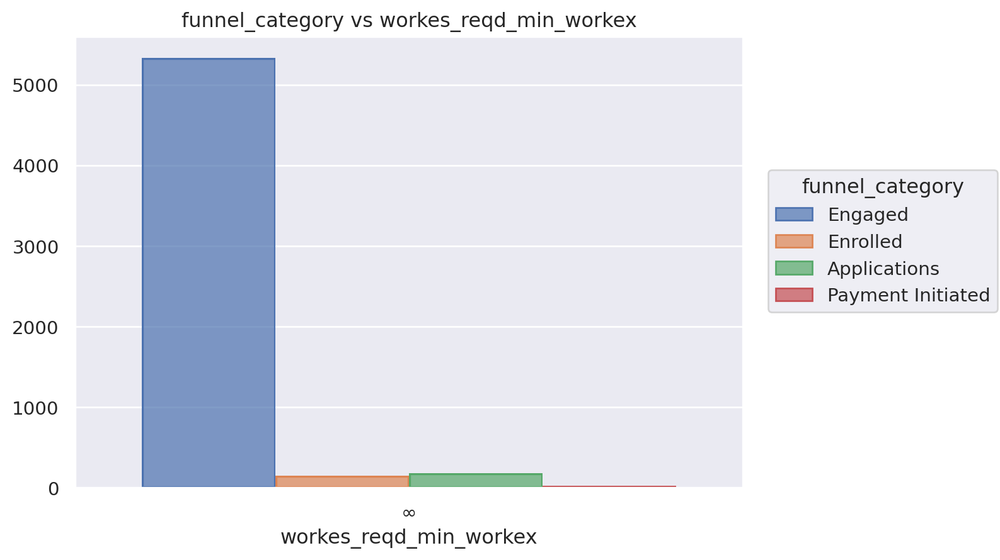

In [ ]:
title = "funnel_category vs workes_reqd_min_workex"
x = "workes_reqd_min_workex"
color = "funnel_category"
so.Plot(df[(df['workes_reqd_min_workex']== '∞') & (df['funnel_category'] != 'Wasted_leads')], x= x, color = color).add(so.Bar(), so.Hist(), so.Dodge()).label(title=title)

We will use the replace the infinity symbol with 99.


In [ ]:
display(target_subtarget_map)
list_order = []
for _, list in target_subtarget_map.items():
    list_order.extend(list)

{'Wasted_leads': ['Cold', 'Dead'],
 'Applications': ['Offered',
  'Registered - Form Incomplete',
  'Registration Initiated',
  'Dropout',
  'Registered - Form Complete',
  'Sent to the institute',
  'Rejected',
  'Offered - Document completed',
  'Offer Declined',
  'PI Scheduled',
  'Eligible for Test',
  'On Hold by the Institute'],
 'Engaged': ['Contacted',
  'Warm',
  'Enquiry',
  'Reinquired',
  'Attempt To contact',
  'Call back'],
 'Payment Initiated': ['T+3', 'T7+', 'T+7'],
 'Enrolled': ['Enrolled']}

<Axes: xlabel='ageing', ylabel='stagename'>

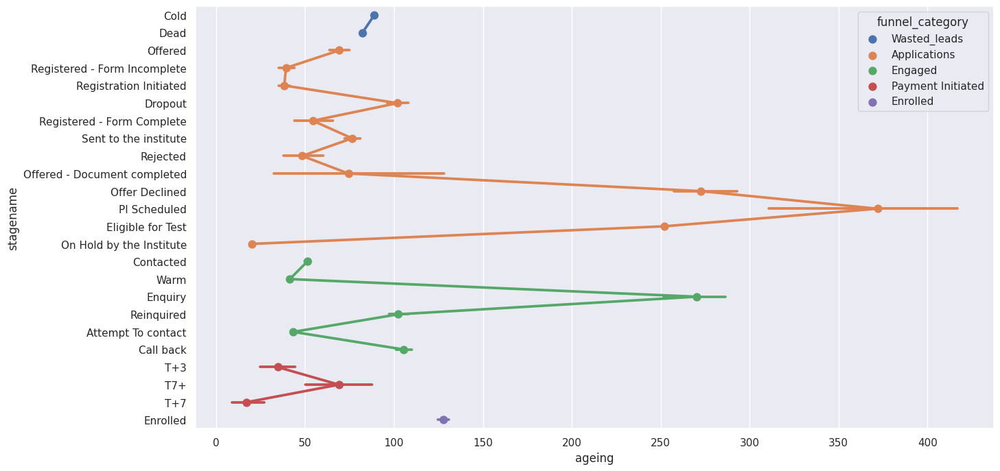

In [ ]:
sns.pointplot(data = df, y = 'stagename', hue ='funnel_category', x = 'ageing', order=list_order)

In [ ]:
modes_df[['workes_reqd_min_workex']]

,workes_reqd_min_workex
stagename,
Attempt To contact,2
Call back,5
Cold,2
Contacted,2
Dead,2
Dropout,2
Eligible for Test,2
Enquiry,3
Enrolled,2


In [ ]:
count_missing(0)

('Applications',
 8096,
 {'shape': (8096, 68),
  'missing': {'unserviced_age': 10,
   'time_taken_for_allocation': 68,
   'calldurationinseconds': 1970,
   'days_to_engage': 8096,
   'days_to_enroll': 8096,
   'days_to_payment': 8096,
   'days_to_waste': 8096,
   'laststagechangedate': 11,
   'lastactivitydate': 7,
   'program_start_date_c': 1117,
   'program_end_date_c': 1117,
   'workes_reqd_min_workex': 28,
   'workex_minworkexp_reqd': 28}})

In [ ]:
count_missing(1)

('Engaged',
 89782,
 {'shape': (89782, 68),
  'missing': {'unserviced_age': 22,
   'time_taken_for_allocation': 1375,
   'calldurationinseconds': 26143,
   'days_to_apply': 89782,
   'days_to_enroll': 89782,
   'days_to_payment': 89782,
   'days_to_waste': 89782,
   'laststagechangedate': 688,
   'lastactivitydate': 59,
   'program_start_date_c': 10747,
   'program_end_date_c': 10747,
   'workes_reqd_min_workex': 375,
   'workex_minworkexp_reqd': 375}})

In [ ]:
count_missing(2)

('Enrolled',
 6562,
 {'shape': (6562, 68),
  'missing': {'unserviced_age': 7,
   'time_taken_for_allocation': 168,
   'calldurationinseconds': 2733,
   'days_to_apply': 6562,
   'days_to_engage': 6562,
   'days_to_payment': 6562,
   'days_to_waste': 6562,
   'laststagechangedate': 21,
   'lastactivitydate': 1,
   'program_start_date_c': 58,
   'program_end_date_c': 58,
   'workes_reqd_min_workex': 10,
   'workex_minworkexp_reqd': 10}})

In [ ]:
count_missing(3)

('Payment Initiated',
 578,
 {'shape': (578, 68),
  'missing': {'unserviced_age': 4,
   'calldurationinseconds': 237,
   'days_to_apply': 578,
   'days_to_engage': 578,
   'days_to_enroll': 578,
   'days_to_waste': 578,
   'laststagechangedate': 3,
   'program_start_date_c': 111,
   'program_end_date_c': 111}})

In [ ]:
count_missing(4)

('Wasted_leads',
 390935,
 {'shape': (390935, 68),
  'missing': {'unserviced_age': 28,
   'time_taken_for_allocation': 2110,
   'calldurationinseconds': 115123,
   'days_to_apply': 390935,
   'days_to_engage': 390935,
   'days_to_enroll': 390935,
   'days_to_payment': 390935,
   'laststagechangedate': 165,
   'lastactivitydate': 6,
   'program_start_date_c': 16330,
   'program_end_date_c': 16330,
   'workes_reqd_min_workex': 966,
   'workex_minworkexp_reqd': 966}})

In [ ]:
df[df['funnel_category'] == facets[0]].head()

,opportunity_id,stagename,subsource,unanswered_call_counter,unserviced_age,ageing,source,opportunity_created_date,time_taken_for_allocation,no_of_calls,calldurationinseconds,funnel_category,days_to_apply,days_to_engage,days_to_enroll,days_to_payment,days_to_waste,city,city_type,workexp,workexp_min,workexp_max,laststagechangedate,is_serviced_c,sales_end_,sales_start_date,program_number,program_code_renewed,total_program_fee,category,business_vertical,budget,lastactivitydate,institute,cal_diff,call2_diff,call3_diff,call4_diff,year,month,month_name,week_of_year,week_of_month,day_of_year,day_of_week,day_name,age,agemin,agemax,competitor_program_feehigh,competitor_program_feelow,program_start_date_c,program_end_date_c,sales_working_day,time_of_lead,hour,iscreatedinworking_hour,workex_reqd,is_session_working_day,session_start_day_inweek,weekly_sessionsdays_count,sessions_in_week,workes_reqd_min_workex,workex_reqd_workexpmax,workex_minworkexp_reqd,workex_max_reqd,workex_reqd_agemax,workex_reqd_agemin
53109,0060o00001YEUzlAAH,Offered,facebook,0,0.000,177,webinar,09-08-2021 02:42,0.000,15,NaN,Applications,25.458,NaN,NaN,NaN,NaN,Gwalior,Tier-2,1-5 years,1,5,03-09-2021 13:42,True,25-Sep-21,24-Jun-21,P-00138,IITD - EMPED,100000,Entrepreneurship,MDP,948000,03-09-2021 00:00,IIT Delhi,0,0,0,0,2021,8,August,33,3,221,0,Monday,22-27 years,22,27,150000.000,66666.667,09-Sep-21,22-May-22,1,02:42:56,2,0,0,0,Sunday,1,1,0,0.000,∞,∞,0.000,0.000
53115,0065j00000fDiLWAA0,Registered - Form Incomplete,facebook,0,0.000,4,facebook,31-05-2022 01:44,0.000,5,NaN,Applications,13.164,NaN,NaN,NaN,NaN,kottayam,Tier-3,5-10 years,5,10,13-06-2022 05:41,True,01-Oct-22,02-May-22,P-00289,IIMK-EPGP,1652000,General Management,LDP,8687000,10-06-2022 00:00,IIM Kozhikode,0,0,0,0,2022,5,May,23,6,151,1,Tuesday,28-33 years,28,33,2478000.000,1101333.333,NaN,NaN,1,01:44:50,1,0,7,1,Thursday,2,2,1.4,0.700,0.714285714,1.428571429,0.212,0.250
53116,0065j00000cwYkeAAE,Registered - Form Incomplete,facebook,0,0.000,4,facebook,11-05-2022 07:58,0.000,4,NaN,Applications,7.086,NaN,NaN,NaN,NaN,Tiruvalla,Tier-3,1-5 years,1,5,18-05-2022 10:02,True,01-Oct-22,02-May-22,P-00289,IIMK-EPGP,1652000,General Management,LDP,8687000,15-05-2022 00:00,IIM Kozhikode,0,0,0,0,2022,5,May,20,3,131,2,Wednesday,22-27 years,22,27,2478000.000,1101333.333,NaN,NaN,1,07:58:20,7,0,7,1,Thursday,2,2,7,1.400,0.142857143,0.714285714,0.259,0.318
53117,0060o00001YDMbYAAX,Registration Initiated,facebook,0,0.000,156,facebook,29-07-2021 16:30,0.000,3,NaN,Applications,26.572,NaN,NaN,NaN,NaN,BEGUSARAI,Tier-3,1-5 years,1,5,25-08-2021 06:13,True,25-Sep-21,24-Jun-21,P-00138,IITD - EMPED,100000,Entrepreneurship,MDP,948000,06-09-2021 00:00,IIT Delhi,0,0,0,0,2021,7,July,31,5,210,3,Thursday,22-27 years,22,27,150000.000,66666.667,09-Sep-21,22-May-22,1,16:30:14,16,1,0,0,Sunday,1,1,0,0.000,∞,∞,0.000,0.000
53118,0060o00001YDlUEAA1,Offered,facebook,0,0.000,147,facebook,04-08-2021 15:54,0.000,4,NaN,Applications,29.914,NaN,NaN,NaN,NaN,Muzaffarpur,Tier-3,1-5 years,1,5,03-09-2021 13:51,True,25-Sep-21,24-Jun-21,P-00138,IITD - EMPED,100000,Entrepreneurship,MDP,948000,15-09-2021 00:00,IIT Delhi,0,0,0,0,2021,8,August,32,2,216,2,Wednesday,22-27 years,22,27,150000.000,66666.667,09-Sep-21,22-May-22,1,15:54:44,15,1,0,0,Sunday,1,1,0,0.000,∞,∞,0.000,0.000
53119,0060o00001VPMvVAAX,Registration Initiated,facebook,0,0.000,156,facebook,20-08-2021 08:01,0.000,3,NaN,Applications,0.001,NaN,NaN,NaN,NaN,Sonipat,Tier-3,1-5 years,1,5,20-08-2021 08:02,True,25-Sep-21,24-Jun-21,P-00138,IITD - EMPED,100000,Entrepreneurship,MDP,948000,06-09-2021 00:00,IIT Delhi,0,0,0,0,2021,8,August,34,4,232,4,Friday,22-27 years,22,27,150000.000,66666.667,09-Sep-21,22-May-22,1,08:01:36,8,0,0,0,Sunday,1,1,0,0.000,∞,∞,0.000,0.000
53120,0060o00001WHJ0LAAX,Offered,facebook,0,0.000,228,facebook,24-04-2021 07:39,0.000,5,NaN,Applications,45.310,NaN,NaN,NaN,NaN,Bhagalpur,Tier-3,5-10 years,5,10,08-06-2021 15:05,True,05-Oct-21,12-Apr-21,P-00119,IITD-CPSCM,70800,Supply Chain Management,MDP,980000,

In [ ]:
df[df['funnel_category'] == facets[1]].shape[0],facet_missing_vals[facets[1]]

(89782,
 {'shape': (89782, 68),
  'missing': {'subsource': 92,
   'unserviced_age': 22,
   'source': 23,
   'time_taken_for_allocation': 1375,
   'calldurationinseconds': 26143,
   'days_to_apply': 89782,
   'days_to_enroll': 89782,
   'days_to_payment': 89782,
   'days_to_waste': 89782,
   'city': 3,
   'laststagechangedate': 688,
   'lastactivitydate': 59,
   'program_start_date_c': 10747,
   'program_end_date_c': 10747,
   'workes_reqd_min_workex': 375,
   'workex_minworkexp_reqd': 375}})

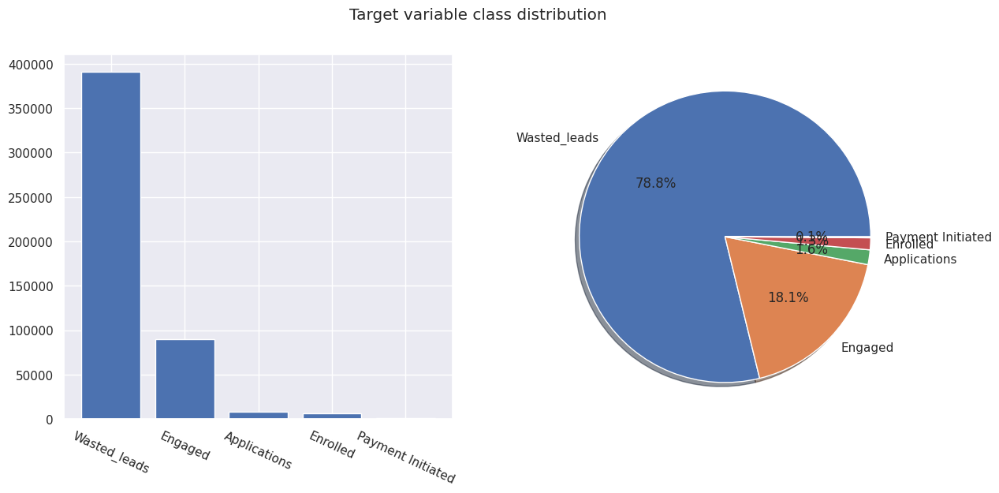

In [ ]:
'''
Lets Understand the target class distribution
Plot target variable distribution
'''

# Create figure object
plt.figure(figsize=(14, 6))

# Create bar plot
plt.subplot(1, 2, 1)
plt.bar(df['funnel_category'].value_counts().index, df['funnel_category'].value_counts().values)
plt.xticks(rotation = 335)

# Create pie plot
plt.subplot(1, 2, 2)
plt.pie(
    x = df['funnel_category'].value_counts(),
    labels=df['funnel_category'].value_counts().index,
    autopct='%1.1f%%',
    shadow=True)

# Add title and display plot
plt.suptitle(f'Target variable class distribution' , fontdict={'size': 10})
plt.show;

This is a heavily imbalanced dataset. We might have to augment the dataset further or implement an undersample-oversample strategy.


Since `funnel_category` is a reduction of `stagename`, lets check the distribution of `stagename` within each `funnel_category`.


In [ ]:
'''
Since `funnel_category` is a reduction of `stagename`,
lets check the distribution of `stagename` within each `funnel_category`
'''
display(df['funnel_category'].value_counts())
print()
display(df[['funnel_category','stagename']].groupby('funnel_category').value_counts())

Wasted_leads         390935
Engaged               89782
Applications           8096
Enrolled               6562
Payment Initiated       578
Name: funnel_category, dtype: int64

funnel_category    stagename                   
Applications       Registration Initiated            2298
                   Sent to the institute             1526
                   Dropout                           1417
                   Registered - Form Incomplete      1160
                   Offered                           1098
                   Registered - Form Complete         288
                   Rejected                           268
                   Offer Declined                      18
                   PI Scheduled                        12
                   Offered - Document completed         9
                   Eligible for Test                    1
                   On Hold by the Institute             1
Engaged            Attempt To contact               33086
                   Warm                             27337
                   Contacted                        26327
                   Reinquired                        2491
                   Enqui

There are 2 possible conversion pathways:
- Engaged -> Applications -> Wasted
- Engaged -> Applications -> Enrolled -> Payment Initiated

Need a definition of Payment Initiated. Is token amount paid? is it refundable? Is it transferable? If refundable, then its not a guarantee that the sale happens, so have to be encoded accordingly.

### 2.1 Object Types and Categorical Features

Infinity is ∞

In [ ]:
'''Lets preprocess the cardinal features'''
month_names_dict = {'January': 1,
             'February': 2,
             'March': 3,
             'April': 4,
             'May': 5,
             'June': 6,
             'July': 7,
             'August': 8,
             'September': 9,
             'October': 10,
             'November': 11,
             'December': 12}
df['month_name'] = df['month_name'].replace(month_names_dict)

day_names_dict = {'Monday': 1,
             'Tuesday': 2,
             'Wednesday': 3,
             'Thursday': 4,
             'Friday': 5,
             'Saturday': 6,
             'Sunday': 7}
df['session_start_day_inweek'] = df['session_start_day_inweek'].replace(day_names_dict)
df['day_name'] = df['day_name'].replace(day_names_dict)

## Interpretation of '∞' required in these columns
display(df[df.workes_reqd_min_workex == '∞'].shape,
df[df.workex_minworkexp_reqd == '∞'].shape,
df[df.workex_max_reqd == '∞'].shape)

df[['workes_reqd_min_workex','workex_minworkexp_reqd','workex_max_reqd']] = df[['workes_reqd_min_workex','workex_minworkexp_reqd','workex_max_reqd']].replace('∞', None)

(38014, 68)

(29902, 68)

(31281, 68)

## Let's hain some Business Understanding from the data

In [ ]:
df[cardinal]

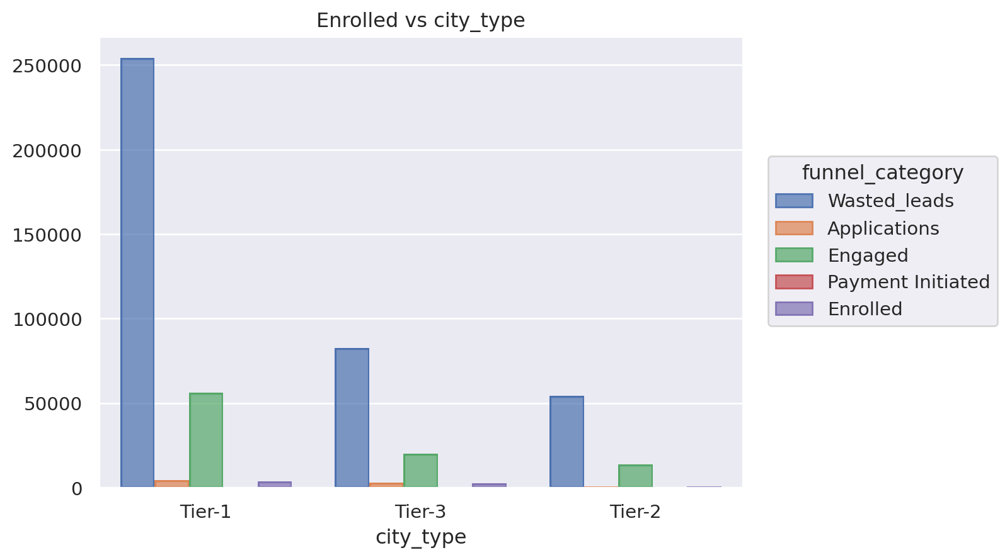

In [ ]:
title = "Enrolled vs city_type"
x = "city_type"
color = "funnel_category"
so.Plot(df, x= x, color = color).add(so.Bar(), so.Hist(), so.Dodge()).label(title=title)

In [ ]:
title = 'Enrolled vs city_type vs age_groups'
data = df[(df['funnel_category'] == 'Enrolled')]
x = "city_type"
color = "funnel_category"
facet = "workexp"


p = so.Plot(data, x=x, color=color).add(so.Bar(), so.Hist(), so.Stack()).label(y=title)
p.facet(facet).layout(size=(16, 6))

In [ ]:
p = so.Plot(df[(df['funnel_category'] == 'Enrolled')], x="city_type",
            color="funnel_category").add(so.Bar(), so.Hist(), so.Stack()).label(y="Enrolled")
p.facet("institute", wrap = 7).layout(size=(16, 9))

- What makes IIM Kozhikode different from others?
- Is it the perceived value of the courses? Could it be the cost?
- Does the value have anything to do with how experienced the students are in their careers?

In [ ]:
progs = ['total_program_fee','competitor_program_feehigh','competitor_program_feelow']
price_compare = df[df['funnel_category'] == 'Enrolled'].groupby(['institute']).agg({'total_program_fee':'median',
                                                                    'competitor_program_feehigh':'median',
                                                                    'competitor_program_feelow':'median'})[progs] #total_program_fee
price_compare

In [ ]:
plt.figure(figsize=(12,5.5))
plt.plot(price_compare, '-o')
plt.xlabel('Institute')
plt.ylabel('Avg Price')
plt.xticks(rotation=30)
plt.title('Price comparison across offering Institutes')
plt.legend(['Median Program Fee', 'Med. Competitor Fee High', 'Med. Competitor Fee Low'])
plt.savefig('program_fee_price_compare_bw_institutes.png')
plt.show();

In [ ]:
p = so.Plot(df[(df['funnel_category'] == 'Engaged')], x="city_type",
            color="funnel_category").add(so.Bar(), so.Hist(), so.Stack()).label(x = 'Engaged')
p.facet("institute", wrap = 7).layout(size=(16, 6))

In [ ]:
'''
Business verticals:
MDP: Management Development Program
LDP: Leadership Development Program
Tech: Technology
'''

p = so.Plot(df[(df['funnel_category'] == 'Enrolled')], x="city_type",
            color="funnel_category").add(so.Bar(), so.Hist(), so.Stack()).label(y='Enrolled')
p.facet("business_vertical").layout(size=(9, 5))

In [ ]:
p = so.Plot(df[df['funnel_category'] != 'Wasted_leads'], x="funnel_category",
            color="funnel_category").add(so.Bar(), so.Hist(), so.Stack())#.label(y='Enrolled')
p.facet("business_vertical").layout(size=(16, 5))

**Looks like MDP is the most popular business vertical.**

In [ ]:
# For Marketing and Revenue Analysis
df.groupby(['business_vertical', 'program_code_renewed', 'funnel_category']).\
agg({'funnel_category':'count',
     'program_code_renewed':'count',
     'total_program_fee':'median',
     'competitor_program_feehigh':'median',
     'competitor_program_feelow':'median'})

In [ ]:
# For Marketing
df.groupby(['business_vertical', 'program_code_renewed']).\
agg({'program_code_renewed':'count'}).\
unstack(0)['program_code_renewed']['LDP'].dropna()

In [ ]:
# For Marketing
df.groupby(['business_vertical', 'program_code_renewed']).\
agg({'program_code_renewed':'count'}).\
unstack(0)['program_code_renewed']['MDP'].dropna()

In [ ]:
# For Marketing
df.groupby(['business_vertical', 'program_code_renewed']).\
agg({'program_code_renewed':'count'}).\
unstack(0)['program_code_renewed']['Tech'].dropna()

In [ ]:
df.columns

In [ ]:
p = so.Plot(df[(df['funnel_category'] == 'Enrolled')], x="city_type",
            color="funnel_category").add(so.Bar(), so.Hist(), so.Stack())
p.facet("institute", wrap = 7).layout(size=(16, 12))

In [ ]:
display(df.shape)
display(df[df['funnel_category'] == 'Wasted_leads'].shape)

In [ ]:
sum(list(cardinality_counter.values())) - cardinality_counter['opportunity_created_date'] - cardinality_counter['laststagechangedate']

In [ ]:
#choosing a unique value of 25 as the threshold for determining the discreteness of a feature
discrete_features = [features for features in df.columns if len(df[features].unique())<25] # and features not in year_features]
print(f'Discrete numerical features count:{len(discrete_features)} ')

discrete_features

In [ ]:
non_discrete_features = [features for features in df.columns if features not in discrete_features]
df[non_discrete_features].head()

In [ ]:
df[['program_code_renewed', 'program_number']].value_counts().hist(bins=147, figsize=(12,8))

In [ ]:
def corrmap(df = df, title='Correlaton Heatmap', savefig_name='corr_map.jpg', method='spearman',
             numeric_only = True, tick_size = 10, annot_size=14,
             annot_kws=8, cbar=False):

    mask = np.triu(np.ones_like(df.corr(numeric_only=numeric_only), dtype=bool))

    heatmap = sns.heatmap(df.corr(method=method, numeric_only = numeric_only),
                          fmt = '.2f', cbar=cbar, annot = True,
                          annot_kws = {'size': annot_kws}, mask=mask, cmap='BrBG')

    plt.xticks(rotation=80, fontsize= tick_size)
    plt.yticks( fontsize= tick_size)

    heatmap.set_title(title, fontdict={'fontsize':annot_size}, pad=12)
    plt.tight_layout()
    plt.savefig(savefig_name)
    plt.show();